# EDA: breastc

In [1]:
%reload_ext autoreload
%autoreload 2

In [28]:
from sklearn.datasets import load_breast_cancer
from sklearn.decomposition import FastICA
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

from helpers.base_imports import *

## Create new EDA

In [3]:
eda = EDA(name="breastc")
eda

Loading 'edas.csv'
Creating experiment: 'breastc'


Experiment: breastc
Columns: Index(['description', 'n features', 'n samples', 'f/n ratio', 'noise', 'stats',
       'class balance', 'outliers', 'skewness', 'correlations', 'DR potential',
       'dataset'],
      dtype='object')
Datasets: Index(['breastc'], dtype='object', name='dataset')

## Get raw dataset from remote source

In [4]:
# fetch dataset
data = load_breast_cancer(as_frame=True)
data.frame.head(5)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


In [5]:
list(data.target_names)

[np.str_('malignant'), np.str_('benign')]

In [6]:
disp_df(data.frame)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.990,10.38,122.80,1001.0,0.11840,0.27760,0.300100,0.147100,0.2419,0.07871,1.0950,0.9053,8.5890,153.400,0.006399,0.049040,0.053730,0.015870,0.030030,0.006193,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.711900,0.265400,0.4601,0.11890,0
1,20.570,17.77,132.90,1326.0,0.08474,0.07864,0.086900,0.070170,0.1812,0.05667,0.5435,0.7339,3.3980,74.080,0.005225,0.013080,0.018600,0.013400,0.013890,0.003532,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.241600,0.186000,0.2750,0.08902,0
2,19.690,21.25,130.00,1203.0,0.10960,0.15990,0.197400,0.127900,0.2069,0.05999,0.7456,0.7869,4.5850,94.030,0.006150,0.040060,0.038320,0.020580,0.022500,0.004571,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.450400,0.243000,0.3613,0.08758,0
3,11.420,20.38,77.58,386.1,0.14250,0.28390,0.241400,0.105200,0.2597,0.09744,0.4956,1.1560,3.4450,27.230,0.009110,0.074580,0.056610,0.018670,0.059630,0.009208,14.910,26.50,98.87,567.7,0.20980,0.86630,0.686900,0.257500,0.6638,0.17300,0
4,20.290,14.34,135.10,1297.0,0.10030,0.13280,0.198000,0.104300,0.1809,0.05883,0.7572,0.7813,5.4380,94.440,0.011490,0.024610,0.056880,0.018850,0.017560,0.005115,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.400000,0.162500,0.2364,0.07678,0
5,12.450,15.70,82.57,477.1,0.12780,0.17000,0.157800,0.080890,0.2087,0.07613,0.3345,0.8902,2.2170,27.190,0.007510,0.033450,0.036720,0.011370,0.021650,0.005082,15.470,23.75,103.40,741.6,0.17910,0.52490,0.535500,0.174100,0.3985,0.12440,0
6,18.250,19.98,119.60,1040.0,0.09463,0.10900,0.112700,0.074000,0.1794,0.05742,0.4467,0.7732,3.1800,53.910,0.004314,0.013820,0.022540,0.010390,0.013690,0.002179,22.880,27.66,153.20,1606.0,0.14420,0.25760,0.378400,0.193200,0.3063,0.08368,0
7,13.710,20.83,90.20,577.9,0.11890,0.16450,0.093660,0.059850,0.2196,0.07451,0.5835,1.3770,3.8560,50.960,0.008805,0.030290,0.024880,0.014480,0.014860,0.005412,17.060,28.14,110.60,897.0,0.16540,0.36820,0.267800,0.155600,0.3196,0.11510,0
8,13.000,21.82,87.50,519.8,0.12730,0.19320,0.185900,0.093530,0.2350,0.07389,0.3063,1.0020,2.4060,24.320,0.005731,0.035020,0.035530,0.012260,0.021430,0.003749,15.490,30.73,106.20,739.3,0.17030,0.54010,0.539000,0.206000,0.4378,0.10720,0
9,12.460,24.04,83.97,475.9,0.11860,0.23960,0.227300,0.085430,0.2030,0.08243,0.2976,1.5990,2.0390,23.940,0.007149,0.072170,0.077430,0.014320,0.017890,0.010080,15.090,40.68,97.65,711.4,0.18530,1.05800,1.105000,0.221000,0.4366,0.20750,0


In [7]:
X = data.frame.drop(columns="target")
y = data.frame.target
X.shape, y.shape

((569, 30), (569,))

In [20]:
eda.update_param("description", "Classify breast cancer images as malignant or benign.")
eda.update_param("n features", X.shape[1])
eda.update_param("n samples", X.shape[0])
eda.update_param("f/n ratio", len(data.target_names) / X.shape[0])

In [21]:
eda.summary_df

,description,n features,n samples,f/n ratio,noise,stats,class balance,outliers,skewness,correlations,DR potential,dataset
dataset,,,,,,,,,,,,
breastc,Classify breast cancer images as malignant or ...,30,569,0.003515,"None, no missing vals",all have relatively similar variation,"Unbalanced (212M, 357B)",several features have outliers,several features are skewed,NaN,NaN,breastc


## Noise

In [12]:
# check for missing values
X.isna().sum().sum()

np.int64(0)

In [13]:
eda.update_param("noise", "None, no missing vals")

## Stats

In [14]:
skewness = X.skew()
summary_stats = X.describe().T
summary_stats["skewness"] = skewness
summary_stats[["min", "max", "mean", "std", "skewness", "25%", "50%", "75%"]]

,min,max,mean,std,skewness,25%,50%,75%
mean radius,6.981000,28.11000,14.127292,3.524049,0.942380,11.700000,13.370000,15.780000
mean texture,9.710000,39.28000,19.289649,4.301036,0.650450,16.170000,18.840000,21.800000
mean perimeter,43.790000,188.50000,91.969033,24.298981,0.990650,75.170000,86.240000,104.100000
mean area,143.500000,2501.00000,654.889104,351.914129,1.645732,420.300000,551.100000,782.700000
mean smoothness,0.052630,0.16340,0.096360,0.014064,0.456324,0.086370,0.095870,0.105300
mean compactness,0.019380,0.34540,0.104341,0.052813,1.190123,0.064920,0.092630,0.130400
mean concavity,0.000000,0.42680,0.088799,0.079720,1.401180,0.029560,0.061540,0.130700
mean concave points,0.000000,0.20120,0.048919,0.038803,1.171180,0.020310,0.033500,0.074000
mean symmetry,0.106000,0.30400,0.181162,0.027414,0.725609,0.161900,0.179200,0.195700
mean fractal dimension,0.049960,0.09744,0.062798,0.007060,1.304489,0.057700,0.061540,0.066120


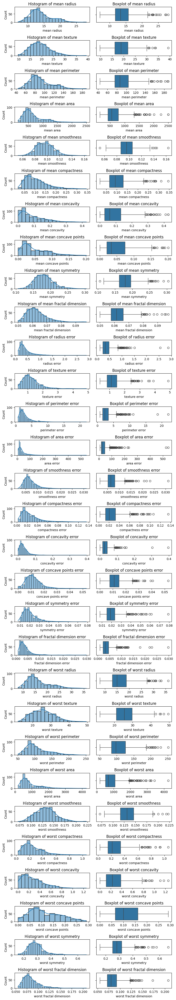

In [15]:
fig, ax = plot_feature_statistics(X, X.columns, line=False)
fig.savefig(f"{FIGS_DIR}/{eda.name}_feature-statistics.png")

In [16]:
eda.update_param("skewness", "several features are skewed")
eda.update_param("stats", "all have relatively similar variation")
eda.update_param("outliers", "several features have outliers")

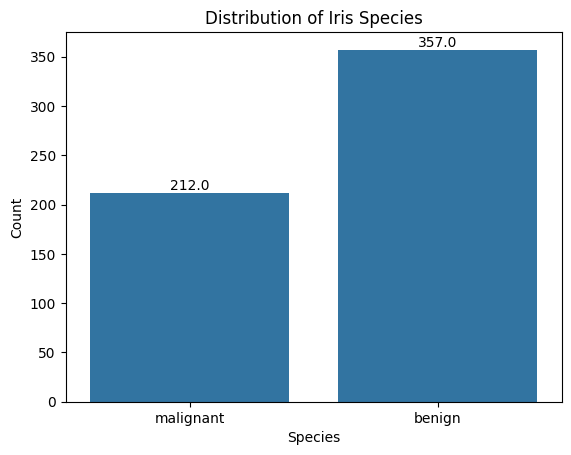

In [17]:
# class distribution of whole dataset
ax = sns.countplot(x=data.target_names[y])
plt.title("Distribution of Iris Species")
plt.xlabel("Species")
plt.ylabel("Count")

# Annotate each bar with the count
for p in ax.patches:
    height = p.get_height()
    ax.annotate(
        f"{height}",
        (p.get_x() + p.get_width() / 2.0, height),
        ha="center",
        va="center",
        xytext=(0, 5),
        textcoords="offset points",
    )

plt.savefig(f"{FIGS_DIR}/{eda.name}_target-class-distribution.png")
plt.show()

In [18]:
eda.update_param("class balance", "Unbalanced (212M, 357B)")

## Feature Correlations

In [19]:
# WAY TOO MANY FEATURES TO DO THIS (can do but takes ~2mins and is not very informative)
# df = data.frame.copy()
# df["target"] = data.target_names[y]
# # df.head(5)
# sns.pairplot(data=df, hue="target", palette="bright")
# plt.savefig(f"{FIGS_DIR}/{eda.name}_pairplot.png")

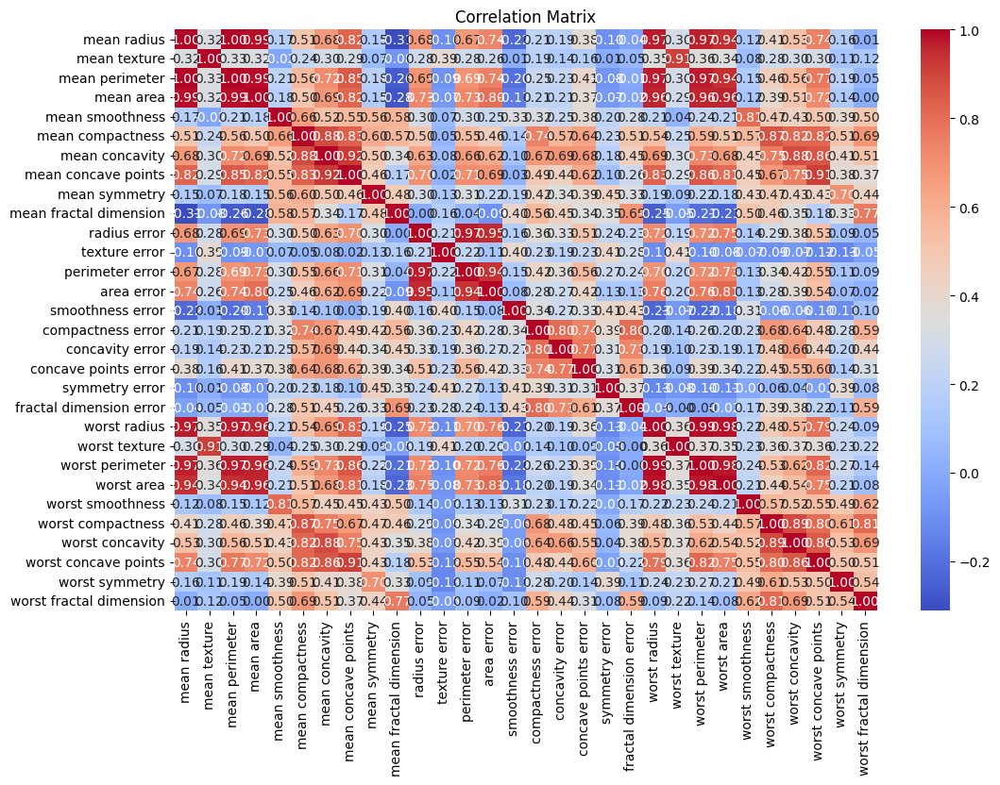

In [22]:
# Create a heatmap of the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(X.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix")

plt.savefig(f"{FIGS_DIR}/{eda.name}_correlation-matrix.png")
plt.show()

In [23]:
eda.update_param(
    "correlations", "some strong (>.8) correlations, many weak correlations"
)

## Dimensionality Reduction Potential

In [29]:
# PCA - number of components to explain 95% variance
pca_pipe = Pipeline(
    [
        ("scaler", StandardScaler()),
        ("pca", PCA()),
    ]
)
pca_pipe.fit(X)

Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA())])

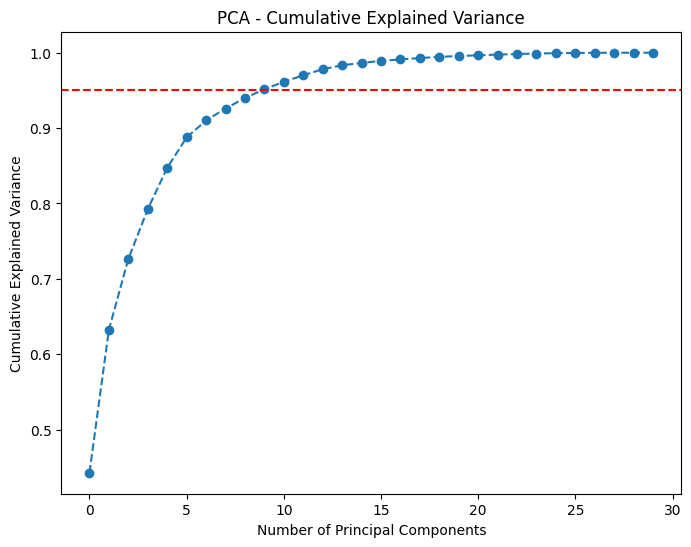

Number of components to explain 95% of the variance: 10


In [30]:
explained_variance_ratio = pca_pipe.named_steps["pca"].explained_variance_ratio_
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

plt.figure(figsize=(8, 6))
plt.plot(cumulative_explained_variance, marker="o", linestyle="--")
plt.xlabel("Number of Principal Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("PCA - Cumulative Explained Variance")
plt.axhline(y=0.95, color="r", linestyle="--")  # Threshold for 95% explained variance
plt.show()

# Number of components to explain 95% variance
num_components_95 = np.argmax(cumulative_explained_variance >= 0.95) + 1
print(f"Number of components to explain 95% of the variance: {num_components_95}")

In [31]:
# ICA - number of independent components
ica_pipe = Pipeline(
    [
        ("scaler", StandardScaler()),
        ("ica", FastICA()),
    ]
)
components = ica_pipe.fit_transform(X)

# Number of independent components
num_independent_components = components.shape[1]
print(f"Number of independent components found: {num_independent_components}")

Number of independent components found: 30


In [32]:
eda.update_param(
    "DR potential",
    "PCA: 95% variance explained with 10 components; ICA: 30 independent components",
)

## Save EDA results

In [33]:
eda.save()

Loading 'edas.csv'
Saving breastc to results/edas.csv


---

# Create and save a shuffled 80/20 train/test split

In [34]:
dataset_name0 = f"{eda.name}-20test-shuffled-v0"
X_train0, X_test0, y_train0, y_test0 = train_test_split(
    X,
    y,
    test_size=0.20,  # 20% of data for testing
    shuffle=True,  # shuffle data before splitting
    random_state=0,
)
X_train0.shape, X_test0.shape

((455, 30), (114, 30))

Make sure train and test target distributions roughly match the original dataset.

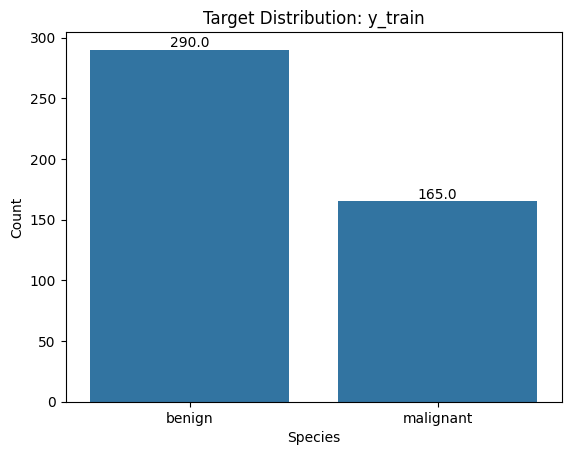

In [35]:
# class distribution: training target dists still balanced?
ax = sns.countplot(x=data.target_names[y_train0])
plt.title("Target Distribution: y_train")
plt.xlabel("Species")
plt.ylabel("Count")

# Annotate each bar with the count
for p in ax.patches:
    height = p.get_height()
    ax.annotate(
        f"{height}",
        (p.get_x() + p.get_width() / 2.0, height),
        ha="center",
        va="center",
        xytext=(0, 5),
        textcoords="offset points",
    )

plt.savefig(f"{FIGS_DIR}/{dataset_name0}_target-class-distribution-y_train.png")
plt.show()

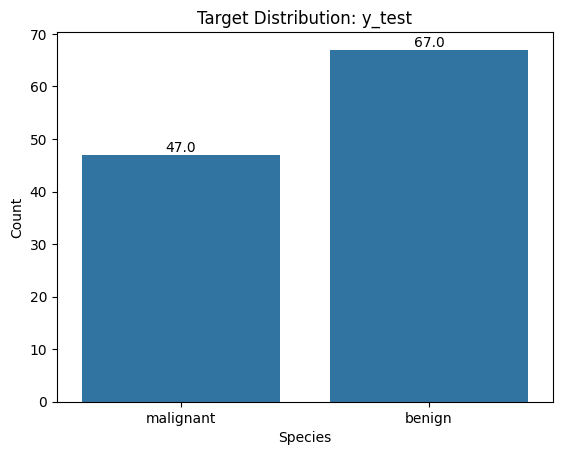

In [36]:
# class distribution: training target dists still balanced?
ax = sns.countplot(x=data.target_names[y_test0])
plt.title("Target Distribution: y_test")
plt.xlabel("Species")
plt.ylabel("Count")

# Annotate each bar with the count
for p in ax.patches:
    height = p.get_height()
    ax.annotate(
        f"{height}",
        (p.get_x() + p.get_width() / 2.0, height),
        ha="center",
        va="center",
        xytext=(0, 5),
        textcoords="offset points",
    )

plt.savefig(f"{FIGS_DIR}/{dataset_name0}_target-class-distribution-y_test.png")
plt.show()

Make sure the feature statistics are similar to the original dataset.

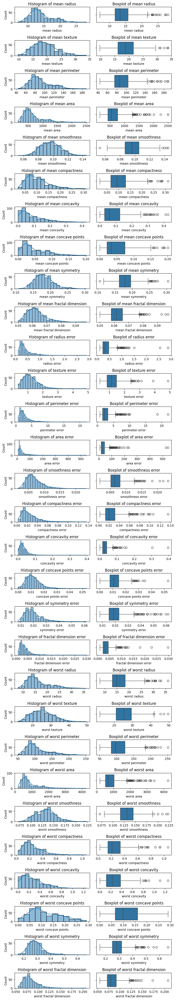

In [37]:
fig, ax = plot_feature_statistics(
    dataframe=X_train0, feature_names=X_train0.columns, line=False
)
fig.savefig(f"{FIGS_DIR}/{dataset_name0}_feature-statistics-X_train.png")

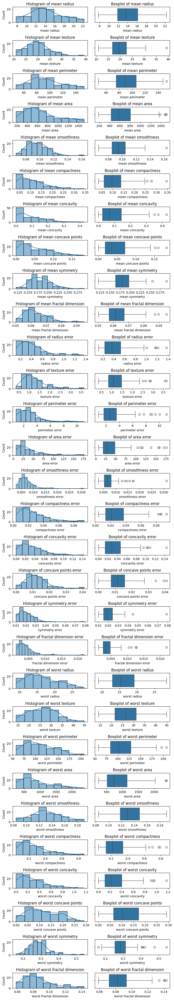

In [38]:
fig, ax = plot_feature_statistics(
    dataframe=X_test0, feature_names=X_test0.columns, line=False
)
fig.savefig(f"{FIGS_DIR}/{dataset_name0}_feature-statistics-X_test.png")

Okay, looks good enough. Lets save it.

In [39]:
save_dataset(
    dataset_name=dataset_name0,
    X_train=X_train0,
    X_test=X_test0,
    y_train=y_train0,
    y_test=y_test0,
    target_names=pd.DataFrame(data.target_names, columns=["target_names"]),
)